In [1]:
import hdbscan
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
%matplotlib inline

In [2]:
symptoms_embeddings = pd.read_csv("../data/embeddings/word_embeddings_dataframe.csv")

In [3]:
dict_symptom = symptoms_embeddings["Symptom"].to_dict()
dict_symptom

{0: 'Abcess',
 1: 'Abdomen',
 2: 'Abortifacient',
 3: 'Abortive',
 4: 'Abrasion',
 5: 'Abscess',
 6: 'Abscess(Breast)',
 7: 'Absorbent',
 8: 'Acaricide',
 9: 'Ache',
 10: 'Ache(Arm)',
 11: 'Ache(Back)',
 12: 'Ache(Body)',
 13: 'Ache(Ear)',
 14: 'Ache(Foot)',
 15: 'Ache(Head)',
 16: 'Ache(Leg)',
 17: 'Ache(Limb)',
 18: 'Ache(Loin)',
 19: 'Ache(Rib)',
 20: 'Ache(Side)',
 21: 'Ache(Stomach)',
 22: 'Achlorhydria',
 23: 'Acne',
 24: 'Acrid',
 25: 'Actinomycosis',
 26: "Addison's-Disease",
 27: 'Adenopathy',
 28: 'Adrenocortical',
 29: 'Adulterant',
 30: 'Aerophagia',
 31: 'Afterbirth',
 32: 'Aftosa',
 33: 'Agility',
 34: 'Ague',
 35: 'Airwick',
 36: 'Alactia',
 37: 'Albuminuria',
 38: 'Alcoholism',
 39: 'Alexipharmic',
 40: 'Alexiteric',
 41: 'Algicide',
 42: 'Allergenic',
 43: 'Allergy',
 44: 'Alopecia',
 45: 'Alterative',
 46: 'Amaurosis',
 47: 'Amblyopia',
 48: 'Amebiasis',
 49: 'Amenorrhea',
 50: 'Amnesia',
 51: 'Amygdalitis',
 52: 'Amygdalosis',
 53: 'Anal-Eversion',
 54: 'Analeptic',


In [4]:
def listify_df_values(df_series: pd.Series):
    df_series = df_series.str.replace("\n", "", regex=True)
    df_series = df_series.str.replace("[", "", regex=True).replace("]", "", regex=True)
    df_series = df_series.str.split(" ")
    return df_series

In [5]:
embeddings1_series = listify_df_values(symptoms_embeddings.loc[:, "Embedding1"])
embeddings1_series = embeddings1_series.apply(lambda row: [val for val in row if val])

In [6]:
embeddings1_df = pd.DataFrame(embeddings1_series)
embeddings1_df = pd.concat(
    [embeddings1_df[c].apply(pd.Series).add_prefix(c + "_") for c in embeddings1_df], axis=1
)

embeddings1_df

,Embedding1_0,Embedding1_1,Embedding1_2,Embedding1_3,Embedding1_4,Embedding1_5,Embedding1_6,Embedding1_7,Embedding1_8,Embedding1_9,...,Embedding1_374,Embedding1_375,Embedding1_376,Embedding1_377,Embedding1_378,Embedding1_379,Embedding1_380,Embedding1_381,Embedding1_382,Embedding1_383
0,-9.81967244e-03,1.01662287e-02,3.75229940e-02,1.75703913e-02,-1.11436069e-01,3.83325890e-02,1.48906738e-01,4.44466770e-02,5.77533916e-02,-1.21526700e-02,...,6.11344092e-02,1.98782869e-02,1.33477971e-02,3.86779606e-02,-4.79677059e-02,3.42200510e-02,4.26308662e-02,3.78118306e-02,6.95859119e-02,-4.20008637e-02
1,5.98840415e-02,1.64022837e-02,-4.90665212e-02,4.81191762e-02,-9.69780684e-02,-1.16978601e-01,1.07039817e-01,2.18950473e-02,4.59282361e-02,-6.05028607e-02,...,4.86743562e-02,1.04232021e-02,1.38152717e-02,-5.32790925e-03,-1.77161284e-02,1.04324900e-01,9.65044126e-02,7.19451010e-02,1.72711313e-02,6.24693604e-03
2,6.30832557e-03,6.94514960e-02,9.17118881e-03,-4.25593607e-04,3.68529968e-02,2.88750455e-02,9.93606523e-02,1.99077209e-03,3.11414283e-02,3.83325480e-02,...,2.25946605e-02,-3.91616262e-02,1.23729361e-02,-2.83677857e-02,-8.51575360e-02,7.25132674e-02,6.53430074e-02,2.26758630e-03,6.07209243e-02,-2.46002264e-02
3,-1.41132241e-02,7.76526034e-02,-8.35783686e-03,2.37053819e-02,5.61783165e-02,3.36992592e-02,1.19458653e-01,-2.01092865e-02,3.62723432e-02,4.82863858e-02,...,6.69673532e-02,1.13059739e-02,-1.16295973e-02,-2.42045093e-02,-5.78260906e-02,3.89332138e-02,1.18804961e-01,-2.96259206e-02,3.69524844e-02,-9.53654386e-03
4,-7.86128864e-02,-2.58876905e-02,3.46109122e-02,5.58277592e-02,-3.87978852e-02,-5.56877032e-02,1.44394651e-01,2.46080924e-02,-7.19921589e-02,-4.99793142e-02,...,2.83698123e-02,-3.49769071e-02,-2.14673597e-02,1.45020243e-02,5.76726533e-02,3.32759731e-02,1.09838024e-01,-7.57560134e-02,2.23050658e-02,-4.70947437e-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2399,-1.92209315e-02,3.93610820e-02,-8.05331487e-03,-1.88839864e-02,1.07821608e-02,-7.60535970e-02,1.06595382e-01,5.58597855e-02,-2.49612960e-04,-1.84704605e-02,...,2.31999531e-02,5.51964119e-02,-1.61917768e-02,6.19558468e-02,-2.18066014e-02,1.71804782e-02,4.90004942e-02,-4.42138314e-02,5.27935810e-02,1.88747607e-02
2400,2.64672562e-02,-4.77555906e-03,-3.02140005e-02,-2.61425432e-02,-3.36900353e-02,-1.13033682e-01,8.00898746e-02,5.02843335e-02,-1.70364957e-02,1.48580121e-02,...,-1.41694313e-02,6.69747815e-02,6.27062470e-02,1.41177222e-01,-7.76808560e-02,6.27785251e-02,8.16981718e-02,-3.36580649e-02,4.98927645e-02,9.57844872e-03
2401,2.54991353e-02,1.67390481e-02,5.45178875e-02,-1.12884091e-02,2.85636671e-02,-5.56535311e-02,5.83849624e-02,-4.70371544e-03,9.25000161e-02,-4.64275433e-03,...,2.22304687e-02,3.83732654e-02,-2.88097896e-02,-6.03646785e-03,-7.98023343e-02,-1.62580740e-02,1.73452757e-02,-5.45231067e-02,1.05497010e-01,-2.00341363e-02
2402,-4.97031994e-02,1.04058813e-02,1.57771539e-02,7.78019577e-02,4.29792143e-03,1.63108837e-02,7.65634999e-02,1.36114378e-02,-5.57998866e-02,2.25542802e-02,...,-9.64850485e-02,9.33009025e-04,5.58457756e-03,3.17276493e-02,1.84024610e-02,-2.05374248e-02,4.81370240e-02,-7.93446414e-03,-1.34081161e-02,1.22985832e-01


In [7]:
embeddings1_df = embeddings1_df.apply(pd.to_numeric, errors='coerce')

In [8]:
embeddings1_df

,Embedding1_0,Embedding1_1,Embedding1_2,Embedding1_3,Embedding1_4,Embedding1_5,Embedding1_6,Embedding1_7,Embedding1_8,Embedding1_9,...,Embedding1_374,Embedding1_375,Embedding1_376,Embedding1_377,Embedding1_378,Embedding1_379,Embedding1_380,Embedding1_381,Embedding1_382,Embedding1_383
0,-0.009820,0.010166,0.037523,0.017570,-0.111436,0.038333,0.148907,0.044447,0.057753,-0.012153,...,0.061134,0.019878,0.013348,0.038678,-0.047968,0.034220,0.042631,0.037812,0.069586,-0.042001
1,0.059884,0.016402,-0.049067,0.048119,-0.096978,-0.116979,0.107040,0.021895,0.045928,-0.060503,...,0.048674,0.010423,0.013815,-0.005328,-0.017716,0.104325,0.096504,0.071945,0.017271,0.006247
2,0.006308,0.069451,0.009171,-0.000426,0.036853,0.028875,0.099361,0.001991,0.031141,0.038333,...,0.022595,-0.039162,0.012373,-0.028368,-0.085158,0.072513,0.065343,0.002268,0.060721,-0.024600
3,-0.014113,0.077653,-0.008358,0.023705,0.056178,0.033699,0.119459,-0.020109,0.036272,0.048286,...,0.066967,0.011306,-0.011630,-0.024205,-0.057826,0.038933,0.118805,-0.029626,0.036952,-0.009537
4,-0.078613,-0.025888,0.034611,0.055828,-0.038798,-0.055688,0.144395,0.024608,-0.071992,-0.049979,...,0.028370,-0.034977,-0.021467,0.014502,0.057673,0.033276,0.109838,-0.075756,0.022305,-0.047095
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2399,-0.019221,0.039361,-0.008053,-0.018884,0.010782,-0.076054,0.106595,0.055860,-0.000250,-0.018470,...,0.023200,0.055196,-0.016192,0.061956,-0.021807,0.017180,0.049000,-0.044214,0.052794,0.018875
2400,0.026467,-0.004776,-0.030214,-0.026143,-0.033690,-0.113034,0.080090,0.050284,-0.017036,0.014858,...,-0.014169,0.066975,0.062706,0.141177,-0.077681,0.062779,0.081698,-0.033658,0.049893,0.009578
2401,0.025499,0.016739,0.054518,-0.011288,0.028564,-0.055654,0.058385,-0.004704,0.092500,-0.004643,...,0.022230,0.038373,-0.028810,-0.006036,-0.079802,-0.016258,0.017345,-0.054523,0.105497,-0.020034
2402,-0.049703,0.010406,0.015777,0.077802,0.004298,0.016311,0.076563,0.013611,-0.055800,0.022554,...,-0.096485,0.000933,0.005585,0.031728,0.018402,-0.020537,0.048137,-0.007934,-0.013408,0.122986


Distance Matrix:

In [9]:
from scipy.spatial import distance_matrix
import math

In [10]:
def generate_distance_matrix(df : pd.DataFrame,
                distance_metric : str = "euclidean") -> pd.DataFrame: # 2.5k x 2.5k
    if distance_metric == "manhattan":
        p = 1
    elif distance_metric == "euclidean":
        p = 2
    elif distance_metric == "chebychev":
        p = math.inf
    else:
        p = 2
    dis_matrix = distance_matrix(df.values, df.values, p)
    dis_df = pd.DataFrame(dis_matrix)
    return dis_df

In [11]:
df_dist_1 = generate_distance_matrix(embeddings1_df)

## Visualising all clusters:

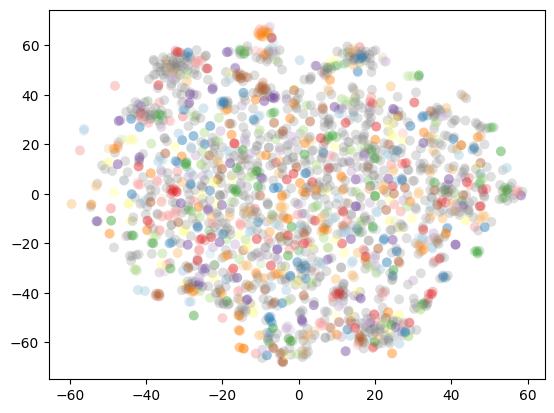

In [12]:
projection = TSNE().fit_transform(embeddings1_df)
clusterer = hdbscan.HDBSCAN(min_samples = 1, min_cluster_size=2, prediction_data=True).fit(embeddings1_df)
color_palette = sns.color_palette('Paired', 800)
cluster_colors = [color_palette[x] if x >= 0
                  else (0.5, 0.5, 0.5)
                  for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in
                         zip(cluster_colors, clusterer.probabilities_)]
plt.scatter(*projection.T, s=50, linewidth=0, c=cluster_member_colors, alpha=0.25)

In [13]:
# plt.figure(figsize=(100,60))

# projection = TSNE().fit_transform(embeddings1_df)
# clusterer = hdbscan.HDBSCAN(min_samples = 1, min_cluster_size=2, prediction_data=True).fit(embeddings1_df)
# color_palette = sns.color_palette('Paired', 800)
# cluster_colors = [color_palette[x] if x >= 0
#                   else (0.5, 0.5, 0.5)
#                   for x in clusterer.labels_]
# cluster_member_colors = [sns.desaturate(x, p) for x, p in
#                          zip(cluster_colors, clusterer.probabilities_)]

# plt.scatter(*projection.T, s=1500, linewidth=0, c=cluster_member_colors, alpha=0.25)

# for i, coords in enumerate(projection):

#     (x, y) = coords

#     label = dict_symptom[i]

#     plt.annotate(label, # this is the text
#                  (x,y), # these are the coordinates to position the label
#                 #  textcoords="offset points", # how to position the text
#                 #  xytext=(0,10), # distance from text to points (x,y)
#                  ha='center', # horizontal alignment can be left, right or center
#                  fontsize=7) 

# plt.ylim(-70, 70)
# plt.xlim(-70, 70)

# plt.show()

In [17]:
for i, sym in dict_symptom.items():
    if sym == "Alcoholism":
        print(i)

38


In [18]:
projection_dict = dict()

for n in range(5):
    projection = TSNE().fit_transform(embeddings1_df)
    projection_dict[f"Projection {n}"] = f"Alcoholism: {projection[38]}, Beer: {projection[270]}"

In [19]:
projection_dict

{'Projection 0': 'Alcoholism: [-11.631839  41.65339 ], Beer: [18.364738 32.148346]',
 'Projection 1': 'Alcoholism: [-44.996513  10.14584 ], Beer: [17.732897 29.192589]',
 'Projection 2': 'Alcoholism: [25.826437 30.993515], Beer: [24.093231 31.975948]',
 'Projection 3': 'Alcoholism: [20.687216 33.007427], Beer: [21.02906 35.11914]',
 'Projection 4': 'Alcoholism: [ 5.5592723 38.060562 ], Beer: [ 5.0150533 40.179188 ]'}

In [20]:
projection[270]

array([ 5.0150533, 40.179188 ], dtype=float32)

In [21]:
dict_symptom[270]

'Beer'

Visualise larger clusters to sort of see how they get grouped in general?

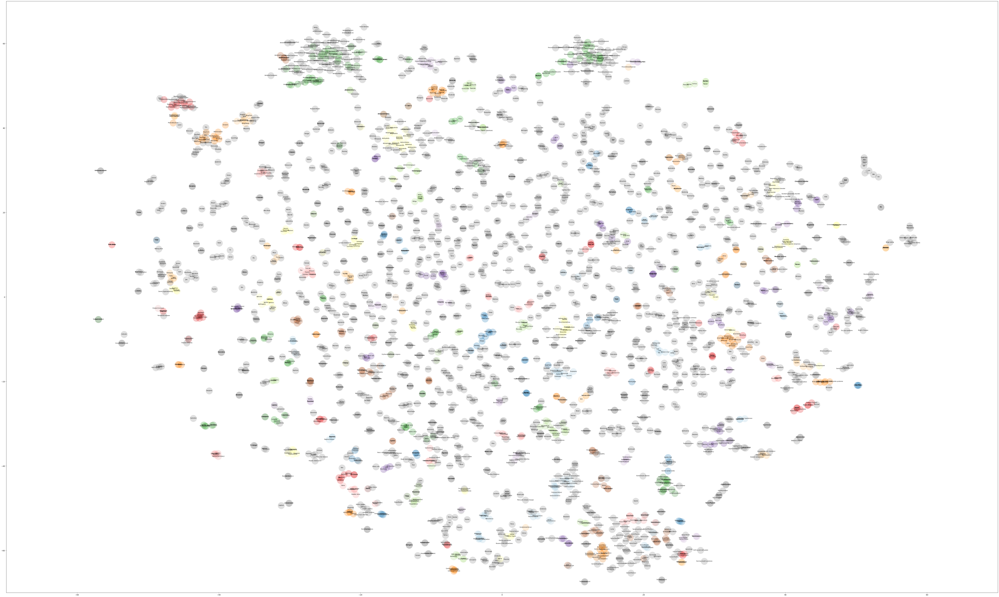

In [23]:
plt.figure(figsize=(100,60))

projection = TSNE().fit_transform(embeddings1_df)
clusterer = hdbscan.HDBSCAN(min_samples = 2, min_cluster_size=3, prediction_data=True).fit(embeddings1_df)
color_palette = sns.color_palette('Paired', 800)
cluster_colors = [color_palette[x] if x >= 0
                  else (0.5, 0.5, 0.5)
                  for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in
                         zip(cluster_colors, clusterer.probabilities_)]

plt.scatter(*projection.T, s=1500, linewidth=0, c=cluster_member_colors, alpha=0.25)

for i, coords in enumerate(projection):

    (x, y) = coords

    label = dict_symptom[i]

    plt.annotate(label, # this is the text
                 (x,y), # these are the coordinates to position the label
                #  textcoords="offset points", # how to position the text
                #  xytext=(0,10), # distance from text to points (x,y)
                 ha='center', # horizontal alignment can be left, right or center
                 fontsize=7) 

plt.ylim(-70, 70)
plt.xlim(-70, 70)

plt.show()

In [24]:
plt.figure(figsize=(120,90))
plt.grid(visible=True)

projection = TSNE().fit_transform(embeddings1_df)
clusterer = hdbscan.HDBSCAN(min_samples = 1, min_cluster_size=2, cluster_selection_epsilon=.75, prediction_data=True).fit(embeddings1_df)
# color_palette = sns.color_palette('Paired', 800)
# cluster_colors = [color_palette[x] if x >= 0
#                   else (0.5, 0.5, 0.5)
#                   for x in clusterer.labels_]
# cluster_member_colors = [sns.desaturate(x, p) for x, p in
#                          zip(cluster_colors, clusterer.probabilities_)]

plt.scatter(*projection.T, s=5, linewidth=0, c="black", alpha=0.85)

for i, coords in enumerate(projection):

    (x, y) = coords
    label = dict_symptom[i]

    plt.annotate(label, # this is the text
                 (x,y), # these are the coordinates to position the label
                 textcoords="offset points", # how to position the text
                 xytext=(0,2), # distance from text to points (x,y)
                 ha='left', # horizontal alignment can be left, right or center
                 fontsize=7) 

plt.ylim(-70, 70)
plt.xlim(-70, 70)

plt.show()

Try without soft clustering and distance matrix instead:

In [109]:
plt.figure(figsize=(120,90))
plt.grid(visible=True)

# projection = TSNE().fit_transform(embeddings1_df)
clusterer = hdbscan.HDBSCAN(min_samples = 1, min_cluster_size=2, 
                            cluster_selection_epsilon=.75, 
                            metric='precomputed').fit(df_dist_1)

cluster_df = pd.DataFrame(clusterer.labels_, columns=["label"])
cluster_df[["x", "y"]] = pd.DataFrame(projection, columns=["x", "y"]) 

n_labels = len(set(clusterer.labels_))

color_palette = sns.color_palette('husl', n_labels)
cluster_colors = [color_palette[x] if x >= 0
                  else (0, 0, 0)
                  for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in
                         zip(cluster_colors, clusterer.probabilities_ * 0.5)]
cluster_prob = clusterer.probabilities_ * 10_000
cluster_prob[cluster_prob == 0] = 20
# plt.scatter(*projection.T, s=10_000, linewidth=0, c=cluster_member_colors, alpha=0.05)
plt.scatter(*projection.T, s=cluster_prob , linewidth=0, c=cluster_member_colors, alpha=0.25)
# plt.scatter(*projection.T, s=5, linewidth=0, c="black", alpha=0.85)

# draw connecting lines
for label_group in cluster_df.label.unique():
    if label_group == -1:
        continue

    points = cluster_df[cluster_df.label == label_group][["x", "y"]].values
    fake_centroids = points.mean(axis = 0)

    for i, point in enumerate(points):

        x = [point[0], fake_centroids[0]]
        y = [point[1], fake_centroids[1]]
        plt.plot(x, y, linewidth=.5, c="black", alpha=1)

for i, coords in enumerate(projection):

    (x, y) = coords
    label = dict_symptom[i]

    plt.annotate(label, # this is the text
                (x,y), # these are the coordinates to position the label
                textcoords="offset points", # how to position the text
                xytext=(2,3), # distance from text to points (x,y)
                ha='left', # horizontal alignment can be left, right or center
                # color="red",
                fontsize=7) 

plt.ylim(-70, 70)
plt.xlim(-70, 70)

plt.show()

In [135]:
plt.figure(figsize=(120,90))
plt.grid(visible=True)

# projection = TSNE().fit_transform(embeddings1_df)
clusterer = hdbscan.HDBSCAN(min_samples = 1, min_cluster_size=2, 
                            cluster_selection_epsilon=.75, 
                            metric='precomputed').fit(df_dist_1)

cluster_df = pd.DataFrame(clusterer.labels_, columns=["label"])
cluster_df[["x", "y"]] = pd.DataFrame(projection, columns=["x", "y"]) 

n_labels = len(set(clusterer.labels_))

color_palette = sns.color_palette('husl', n_labels)
cluster_colors = [color_palette[x] if x >= 0
                  else (0, 0, 0)
                  for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in
                         zip(cluster_colors, clusterer.probabilities_ * 0.5)]
cluster_prob = clusterer.probabilities_ * 1_000
# cluster_prob[cluster_prob == 0] = 20
# plt.scatter(*projection.T, s=10_000, linewidth=0, c=cluster_member_colors, alpha=0.05)
plt.scatter(*projection.T, s=cluster_prob , linewidth=0, c=cluster_member_colors, alpha=0.45)
# plt.scatter(*projection.T, s=5, linewidth=0, c="black", alpha=0.85)

# draw connecting lines
for label_group in cluster_df.label.unique():
    if label_group == -1:
        continue

    points = cluster_df[cluster_df.label == label_group][["x", "y"]].values
    fake_centroids = points.mean(axis = 0)

    for i, point in enumerate(points):

        x = [point[0], fake_centroids[0]]
        y = [point[1], fake_centroids[1]]
        plt.plot(x, y, linewidth=.5, c="black", alpha=1)

for i, coords in enumerate(projection):

    (x, y) = coords
    label = dict_symptom[i]

    plt.annotate(label, # this is the text
                (x,y), # these are the coordinates to position the label
                textcoords="offset points", # how to position the text
                xytext=(2,3), # distance from text to points (x,y)
                ha='left', # horizontal alignment can be left, right or center
                # color="red",
                fontsize=55) 

plt.ylim(52.5, 72.5)
plt.xlim(-10, 10)

plt.show()

In [125]:
plt.figure(figsize=(120,90))
plt.grid(visible=True)

# projection = TSNE().fit_transform(embeddings1_df)
clusterer = hdbscan.HDBSCAN(min_samples = 1, min_cluster_size=2, 
                            cluster_selection_epsilon=.75, 
                            metric='precomputed').fit(df_dist_1)

cluster_df = pd.DataFrame(clusterer.labels_, columns=["label"])
cluster_df[["x", "y"]] = pd.DataFrame(projection, columns=["x", "y"]) 

n_labels = len(set(clusterer.labels_))

color_palette = sns.color_palette('husl', n_labels)
# cluster_colors = [color_palette[x] if x >= 0
#                   else (0, 0, 0)
#                   for x in clusterer.labels_]

cluster_colors = [(0, 0, 0) if x >= 0
                  else (1, 0, 0)
                  for x in clusterer.labels_]

cluster_member_colors = [sns.desaturate(x, p) for x, p in
                         zip(cluster_colors, clusterer.probabilities_ * 0.5)]
cluster_prob = clusterer.probabilities_ * 400
# cluster_prob[cluster_prob == 0] = 200
# cluster_prob[cluster_prob > 200] = 0

# plt.scatter(*projection.T, s=10_000, linewidth=0, c=cluster_member_colors, alpha=0.05)
# plt.scatter(*projection.T, s=cluster_prob , linewidth=0, c=cluster_member_colors, alpha=0.25)
plt.scatter(*projection.T, s=cluster_prob, linewidth=0, c=cluster_colors, alpha=0.9)

# draw connecting lines
for label_group in cluster_df.label.unique():
    if label_group == -1:
        continue

    points = cluster_df[cluster_df.label == label_group][["x", "y"]].values
    fake_centroids = points.mean(axis = 0)

    for i, point in enumerate(points):

        x = [point[0], fake_centroids[0]]
        y = [point[1], fake_centroids[1]]
        plt.plot(x, y, linewidth=.5, c="black", alpha=1)

# for i, coords in enumerate(projection):

#     (x, y) = coords
#     label = dict_symptom[i]

#     plt.annotate(label, # this is the text
#                 (x,y), # these are the coordinates to position the label
#                 textcoords="offset points", # how to position the text
#                 xytext=(2,3), # distance from text to points (x,y)
#                 ha='left', # horizontal alignment can be left, right or center
#                 # color="red",
#                 fontsize=7) 

plt.ylim(-70, 70)
plt.xlim(-70, 70)

plt.show()

In [41]:
len(set(clusterer.labels_))

432

In [ ]:
len()

In [106]:
arr = clusterer.probabilities_

In [53]:
pd.DataFrame(projection)

,0,1
0,14.383460,21.769838
1,29.216455,-30.912706
2,-8.728716,41.329086
3,-8.769104,40.542995
4,-29.947538,-0.796020
...,...,...
2399,50.291431,18.309055
2400,50.302490,18.300417
2401,38.319450,40.057568
2402,33.462746,-3.349355


In [66]:
test_df = pd.DataFrame(clusterer.labels_, columns=["label"])
test_df[["x", "y"]] = pd.DataFrame(projection, columns=["x", "y"]) 

In [137]:
filt = (test_df["label"] == -1)

test_df[filt]

,label,x,y
0,-1,14.383460,21.769838
4,-1,-29.947538,-0.796020
7,-1,-18.539015,-0.007829
30,-1,15.303332,-4.944517
31,-1,2.477690,-61.051052
...,...,...,...
2380,-1,12.663138,27.398411
2386,-1,51.534325,-23.219166
2396,-1,-43.878666,-37.237164
2397,-1,-31.823627,11.105454


In [25]:
# plt.savefig(f'../output/symptoms.png', 
#             transparent = False,  
#             facecolor = 'white'
#             )

13: max 11
2: max 557
6: 80
7, 8, 10: max 1!
9: 28!

In [26]:
clusterer = hdbscan.HDBSCAN(min_samples = 1, min_cluster_size=5, cluster_selection_epsilon=.85, prediction_data=True).fit(embeddings1_df)
set(clusterer.labels_)

{-1,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35}

## Visualising a single herb:

In [27]:
min_dict = dict()

for i, val in enumerate(df_dist_1):
    i_min = np.argmin(df_dist_1[i])
    try:
        left_min = min(df_dist_1[i][:i_min:])
        if left_min == 0:
            left_min = 10
    except:
        left_min = 10
    try:    
        right_min = min(df_dist_1[i][i_min+1::])
        if right_min == 0:
            right_min = 10
    except:
        right_min = 10
    min_dict[i] = min(left_min, right_min)


In [28]:
max_min_val = max(min_dict.values())

for i, min_val in min_dict.items():
    if min_val == max_min_val:
        print(i)

1442


In [29]:
min_min_val = min(min_dict.values())

for i, min_val in min_dict.items():
    if min_val == min_min_val:
        print(i)

1890
1921


In [30]:
len(min_dict)

2404

In [31]:
min_dict[1890]

0.1283884804575315

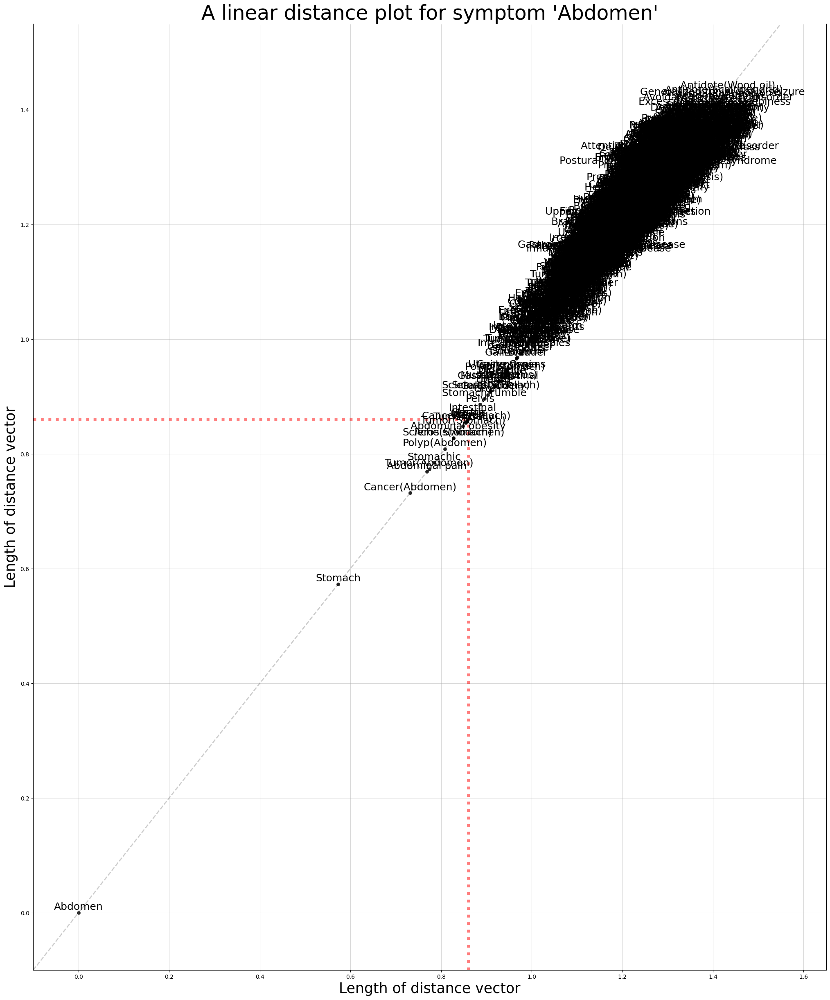

In [32]:
# sns.relplot(data=df_dist_1, x=1, y=1)

target_i = 1

plt.figure(figsize=(25,30))
# plt.figure(figsize=(30,30))
plt.grid(visible=True, alpha = .5)

plt.scatter(df_dist_1[target_i], df_dist_1[target_i], s=40, linewidth=0, c="black", alpha=0.85)

x1, y1 = [-0.1, 0.86], [0.86, 0.86]
x2, y2 = [0.86, 0.86], [-0.1, 0.86]
plt.plot(x1, y1, x2, y2, linestyle = 'dotted', linewidth = 5, c = "red", alpha = .5)

x3, y3 = [-0.1, 1.55], [-0.1, 1.55]
plt.plot(x3, y3, linestyle = 'dashed', linewidth = 2, c = "black", alpha = .2)


for i, vector in enumerate(df_dist_1[target_i]):

    x = vector
    y = vector

    label = dict_symptom[i]

    plt.annotate(label, # this is the text
                 (x,y), # these are the coordinates to position the label
                 textcoords="offset points", # how to position the text
                 xytext=(0,5), # distance from text to points (x,y)
                 ha='center', # horizontal alignment can be left, right or center
                 fontsize=18) 

plt.ylim(-0.1, 1.55)
# plt.ylim(-0.1, 1.65)
plt.xlim(-0.1, 1.65)

plt.title(f"A linear distance plot for symptom '{dict_symptom[target_i]}'", fontsize=35)
plt.xlabel("Length of distance vector", fontsize=25)
plt.ylabel("Length of distance vector", fontsize=25)

plt.show()

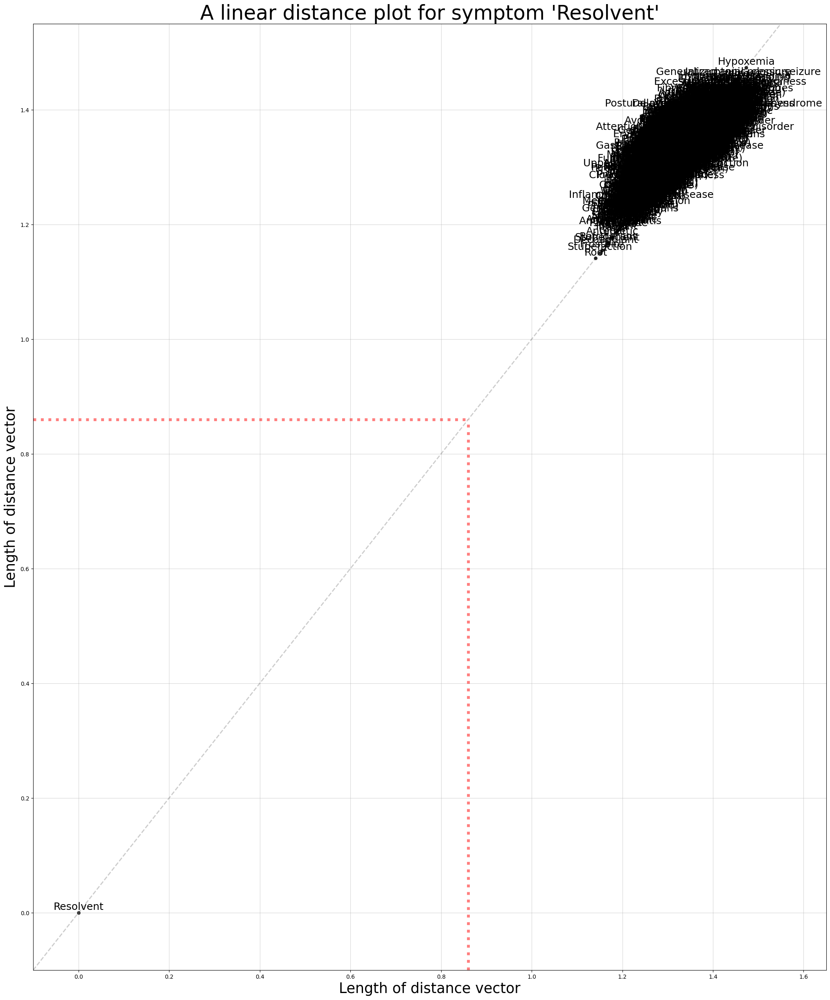

In [33]:
# sns.relplot(data=df_dist_1, x=1, y=1)

target_i = 1442

plt.figure(figsize=(25,30))
# plt.figure(figsize=(30,30))
plt.grid(visible=True, alpha = .5)

plt.scatter(df_dist_1[target_i], df_dist_1[target_i], s=40, linewidth=0, c="black", alpha=0.85)

x1, y1 = [-0.1, 0.86], [0.86, 0.86]
x2, y2 = [0.86, 0.86], [-0.1, 0.86]
plt.plot(x1, y1, x2, y2, linestyle = 'dotted', linewidth = 5, c = "red", alpha = .5)

x3, y3 = [-0.1, 1.55], [-0.1, 1.55]
plt.plot(x3, y3, linestyle = 'dashed', linewidth = 2, c = "black", alpha = .2)

for i, vector in enumerate(df_dist_1[target_i]):

    x = vector
    y = vector

    label = dict_symptom[i]

    plt.annotate(label, # this is the text
                 (x,y), # these are the coordinates to position the label
                 textcoords="offset points", # how to position the text
                 xytext=(0,5), # distance from text to points (x,y)
                 ha='center', # horizontal alignment can be left, right or center
                 fontsize=18) 

plt.ylim(-0.1, 1.55)
# plt.ylim(-0.1, 1.65)
plt.xlim(-0.1, 1.65)

plt.title(f"A linear distance plot for symptom '{dict_symptom[target_i]}'", fontsize=35)
plt.xlabel("Length of distance vector", fontsize=25)
plt.ylabel("Length of distance vector", fontsize=25)

plt.show()